In [20]:
include("../../src/WaterLily.jl")
WaterLily = Main.WaterLily;
using Plots; gr()
using StaticArrays
using JLD
using Images
using FFTW
using Statistics
using Interpolations
using DelimitedFiles
using LinearAlgebra
using PyPlot
using GLMakie
GLMakie.activate!()
using PlotlyJS

In [21]:
inside(a::AbstractArray) = CartesianIndices(map(ax->first(ax)+1:last(ax)-1,axes(a)))
@inline CI(a...) = CartesianIndex(a...)
"""
    δ(i,N::Int)
    δ(i,I::CartesianIndex{N}) where {N}

Return a CartesianIndex of dimension `N` which is one at index `i` and zero elsewhere.
"""
δ(i,::Val{N}) where N = CI(ntuple(j -> j==i ? 1 : 0, N))
δ(i,I::CartesianIndex{N}) where N = δ(i, Val{N}())


δ (generic function with 2 methods)

In [22]:
T=1
function leVeque!(u,x,y,z,t)
    u[:,:,:,1] = @. 2*sin( pi*x)^2*sin(2pi*y)  *sin(2pi*z)  *cos(pi*t/T)*N[1]
    u[:,:,:,2] = @.  -sin(2pi*x)  *sin( pi*y)^2*sin(2pi*z)  *cos(pi*t/T)*N[2]
    u[:,:,:,3] = @.  -sin(2pi*x)  *sin(2pi*y)  *sin( pi*z)^2*cos(pi*t/T)*N[3]
    # u[:,:,:,1] .= 2
    # u[:,:,:,2] .= 1
    # u[:,:,:,3] .= 1
end

function Insidef!(f,dat)
    copyto!(dat,f[inside(f)])
end

Insidef! (generic function with 1 method)

In [23]:
computationID = "cVOFLeVeque"

"cVOFLeVeque"

In [24]:
NN = 256
N = (NN,NN,NN)
D = length(N)
Nd = ((N.+2)...,D)

(258, 258, 258, 3)

In [25]:
ins = WaterLily.cVOF(
    N; 
    InterfaceSDF = (x) -> sqrt.(
        (x[1]-0.35*N[1]-1.5).^2 + (x[2]-0.35*N[2]-1.5).^2 + (x[3]-0.35*N[3]-1.5).^2
    )-N[1]*0.15, 
    perdir=(1,2,3)
)

Main.WaterLily.cVOF{3, Float64, Array{Float64, 3}, Array{Float64, 4}}([0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; … ;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], [0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; … ;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0;;; 0.0 0.0 … 0.0 0

In [26]:
t = LinRange(0,1,4000)

xList = reshape((1:N[1]+2).-2,(N[1]+2,1,1))/N[1]
yList = reshape((1:N[2]+2).-2,(1,N[2]+2,1))/N[2]
zList = reshape((1:N[3]+2).-2,(1,1,N[3]+2))/N[3]

lx,ly,lz = ((1:N[1]).-0.5)/N[1],((1:N[2]).-0.5)/N[2],((1:N[3]).-0.5)/N[3]

u⁰ = zeros(Nd)
u  = zeros(Nd);
leVeque!(u⁰,xList,yList,zList,t[1]);

In [27]:
Statistics.mean(abs.(
    u⁰[3:end, 2:end-1, 2:end-1,1]-u⁰[2:end-1, 2:end-1, 2:end-1,1]+
    u⁰[2:end-1, 3:end, 2:end-1,2]-u⁰[2:end-1, 2:end-1, 2:end-1,2]+
    u⁰[2:end-1, 2:end-1, 3:end,3]-u⁰[2:end-1, 2:end-1, 2:end-1,3]
))

0.027805381885126317

In [32]:
massConserv = []
push!(massConserv,Statistics.mean(ins.f[2:end-1,2:end-1,2:end-1]));

In [ ]:
dat = ins.f[inside(ins.f)] |> Array;
obs = Insidef!(ins.f,dat) |> Observable;
fig, ax, lineplot = GLMakie.contour(obs,levels=[0.5],alpha=1,isorange=0.05)

record(fig, computationID*"_"*"fIso.mp4", 2:size(t)[1]; framerate=15) do i
    push!(massConserv,Statistics.mean(ins.f[2:end-1,2:end-1,2:end-1]))
    leVeque!(u,xList,yList,zList,t[i])
    WaterLily.freeint_update!(t[i]-t[i-1], ins.f, ins.f⁰, ins.n̂, ins.α, u⁰, u, ins.ϕᶠ, ins.c̄, perdir=ins.perdir, dirdir=ins.dirdir)
    u⁰ .= u
    obs[] = Insidef!(ins.f,dat)
    println(i)
end

In [33]:
i=1

1

In [37]:
i+=1
leVeque!(u,xList,yList,zList,t[i])
WaterLily.freeint_update!(t[i]-t[i-1], ins.f, ins.f⁰, ins.n̂, ins.α, u⁰, u, ins.ϕᶠ, ins.c̄, perdir=ins.perdir, dirdir=ins.dirdir)
u⁰ .= u;
i

5

In [41]:
maximum(abs.(u[:,:,:,1]))

1.9999901254670711

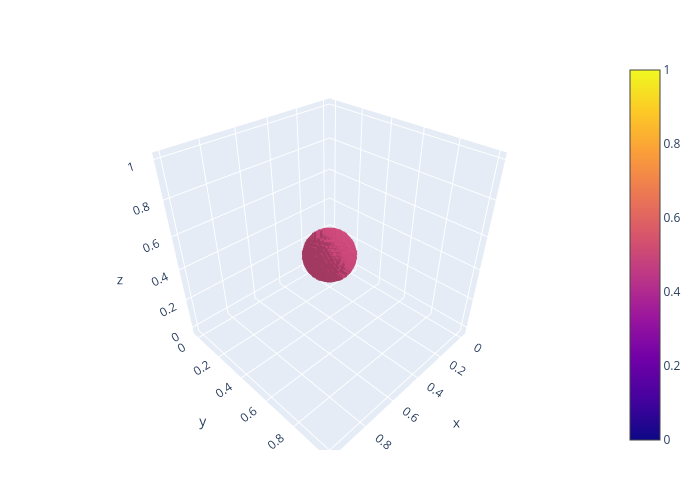

In [38]:
X,Y,Z = mgrid(xList,yList,zList)
PlotlyJS.plot(
    isosurface(
        x=X[:], y=Y[:], z=Z[:],
        value=ins.f[:],
        isomin=0.5, isomax=0.5,surface_count=1,
        caps=attr(x_show=false, y_show=false)
    )
)